In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl

from matplotlib import pyplot as plt

%matplotlib inline
sns.set_style("whitegrid")

plt.rc("figure", figsize=(11,6))
plt.rc("font", size=15)

print("Pandas Version: " + pd.__version__)
print("Numpy Version: " + np.__version__)
print("Seaborn Version: " + sns.__version__)

Pandas Version: 1.2.4
Numpy Version: 1.18.5
Seaborn Version: 0.11.1


In [2]:
users = pd.read_csv("../../data/clean/users.csv", parse_dates=["date_from_min", "date_from_max"], index_col="user_id")
users.head(3)

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,trips_per_day,mean_time_between_trips
user_id,,,,,,,,,,,
0000020B772C8D71F4F9AE4835D6C9F032FDBE21,2014-08-03 00:43:54,2017-05-12 19:42:34,66,1013,1017,3,12.393939,1.685233,8.385693,0.065153,15 days 14:19:21.846153846
000004354587D5BAC99A2171DE2F4ACD30AA8635,2014-03-10 08:42:55,2016-11-17 12:11:25,8,983,1162,179,15.625000,1.089574,4.221271,0.008138,140 days 10:46:55.714285714
00005721E978458AD348C24219138429BC84574A,2016-06-19 21:02:32,2017-05-15 16:05:15,99,329,330,0,10.252525,1.454124,8.849686,0.300912,3 days 08:45:56.765306122


In [10]:
trips = pd.read_csv("../../data/clean/trips.csv")
trips.head(3)

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh,time_since_last_checkout
0,119911,341973A96CDE0DF9792F6C844622735AE4216EBF,2014-01-01 00:02:51,2014-01-01 00:20:04,Enckeplatz / Hütten,131887,Königstraße / Struenseestraße,131650,Terminal HH_8 (-2624-),18,2.364129,7.880431,NaN
1,118994,665D79F269FA03F84FC61F3A7F7B078D7392EC0E,2014-01-01 00:07:45,2014-01-01 00:10:48,Isestraße / Hoheluftbrücke,140804,Isestraße / Hoheluftbrücke,140804,Terminal HH_63 (-2241-),4,0.000000,0.000000,NaN
2,143660,B46B52FDC494E46849DB84BF84F0B99C78358E59,2014-01-01 00:09:55,2014-01-01 00:26:20,Schulterblatt/Eifflerstraße,131648,Schulterblatt/Eifflerstraße,131648,Android SRH,17,0.000000,0.000000,NaN


In [3]:
users["mean_time_between_trips_in_hours"] = users["mean_time_between_trips"] / np.timedelta64(1, "h")

In [5]:
users.describe()

,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,trips_per_day,mean_time_between_trips_in_hours
count,199319.000000,199319.000000,199319.000000,199319.000000,199319.000000,199319.000000,199319.000000,1.993190e+05,199319.000000
mean,37.996042,447.761066,788.476141,340.302911,15.889050,1.962053,7.597678,inf,865.099689
std,81.987663,415.452376,369.557444,343.090247,4.839816,0.763988,1.866533,NaN,1703.336852
min,2.000000,0.000000,0.000000,0.000000,2.088652,0.088032,0.198404,1.639344e-03,0.000000
25%,5.000000,33.000000,419.000000,36.000000,12.500000,1.428847,6.477419,2.880000e-02,66.313926
50%,13.000000,343.000000,920.000000,242.000000,15.500000,1.873372,7.748594,7.894737e-02,329.238394
75%,37.000000,819.000000,1123.000000,603.000000,18.833333,2.390613,8.858107,4.063080e-01,931.478814
max,2712.000000,1230.000000,1231.000000,1231.000000,33.000000,7.891597,14.924683,inf,29281.518333


In [6]:
def display_distribution(attribute, label, bins):
    values = users[[attribute]]
    plt.figure(figsize=(16,5))
    plt.hist(values, alpha=0.7, bins=bins)
    plt.xlabel(label)
    plt.ylabel("count")
    plt.savefig("figures/users_hist_%s.pdf"%attribute, bbox_inches="tight")
    plt.show()

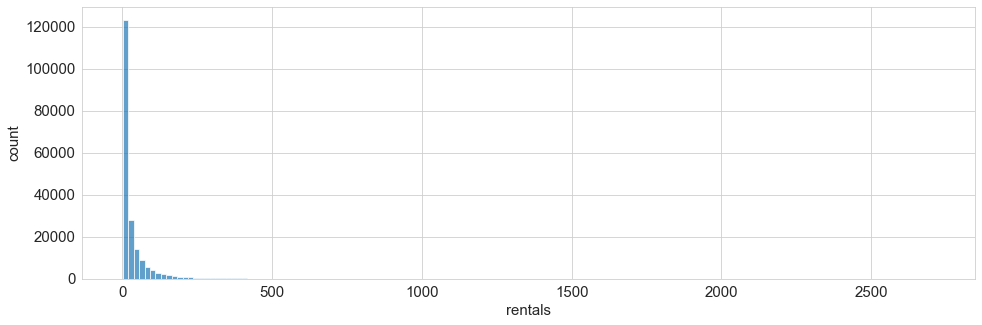

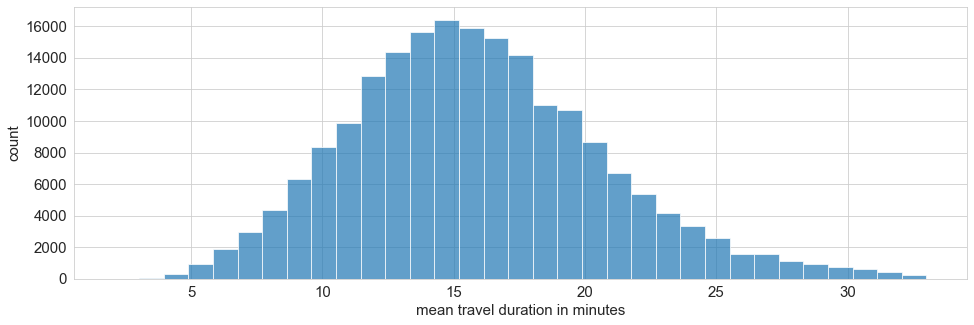

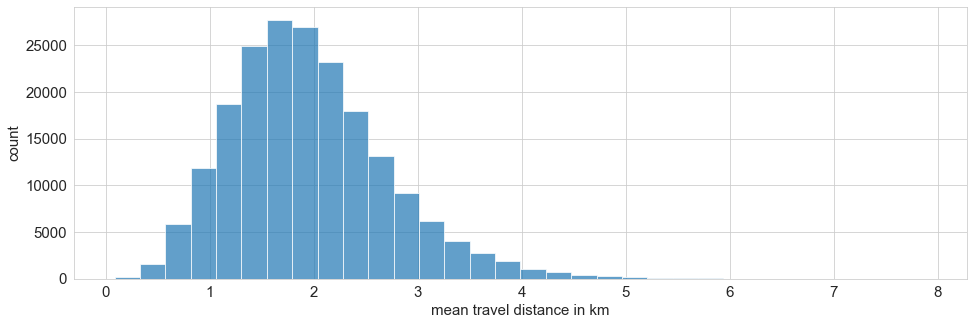

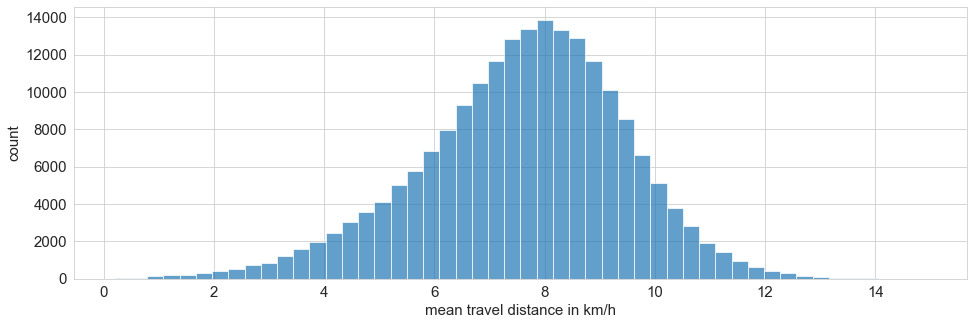

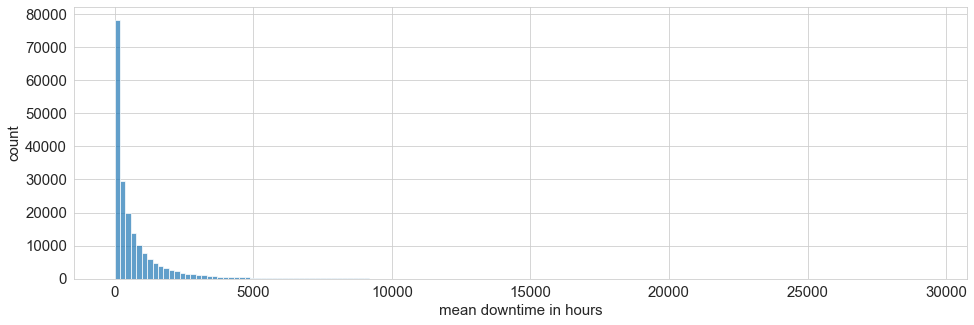

In [7]:
display_distribution("trips_count", label="rentals", bins=150)
display_distribution("mean_duration_in_min", label="mean travel duration in minutes", bins=33)
display_distribution("mean_distance_in_km", label="mean travel distance in km", bins=32)
display_distribution("mean_speed_in_kmh", label="mean travel distance in km/h", bins=50)
display_distribution("mean_time_between_trips_in_hours", label="mean downtime in hours", bins=150)

In [11]:
users[users.mean_time_between_trips_in_hours == users.mean_time_between_trips_in_hours.max()]

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,trips_per_day,mean_time_between_trips,mean_time_between_trips_in_hours
user_id,,,,,,,,,,,,
1019A0B049403C590748B581BFE67896A3CB220E,2014-01-08 21:46:39,2017-05-12 23:17:45,2,1220,1223,3,31.0,5.075337,9.848343,0.001639,1220 days 01:31:06,29281.518333


In [12]:
trips[trips.user_id == "1019A0B049403C590748B581BFE67896A3CB220E"]

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh,time_since_last_checkout
24886,143711,1019A0B049403C590748B581BFE67896A3CB220E,2014-01-08 21:46:39,2014-01-08 22:15:12,Große Bergstraße / Jessenstraße,131649,Mannesallee/Veringstraße,199402,Terminal HH_46 (-2115-),29,4.948156,10.237563,NaN
7576458,143723,1019A0B049403C590748B581BFE67896A3CB220E,2017-05-12 23:17:45,2017-05-12 23:50:08,Neuer Pferdemarkt / Beim Grünen Jäger,131890,Mannesallee/Veringstraße,199402,Terminal HH_49 (-2131-),33,5.202518,9.459123,1220 days 01:31:06


In [39]:
users.describe()

,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,trips_per_day,mean_time_between_trips_in_hours
count,199319.000000,199319.000000,199319.000000,199319.000000,199319.000000,199319.000000,199319.000000,1.993190e+05,199319.000000
mean,37.996042,447.761066,788.476141,340.302911,15.889050,1.962053,7.597678,inf,865.099689
std,81.987663,415.452376,369.557444,343.090247,4.839816,0.763988,1.866533,NaN,1703.336852
min,2.000000,0.000000,0.000000,0.000000,2.088652,0.088032,0.198404,1.639344e-03,0.000000
25%,5.000000,33.000000,419.000000,36.000000,12.500000,1.428847,6.477419,2.880000e-02,66.313926
50%,13.000000,343.000000,920.000000,242.000000,15.500000,1.873372,7.748594,7.894737e-02,329.238394
75%,37.000000,819.000000,1123.000000,603.000000,18.833333,2.390613,8.858107,4.063080e-01,931.478814
max,2712.000000,1230.000000,1231.000000,1231.000000,33.000000,7.891597,14.924683,inf,29281.518333


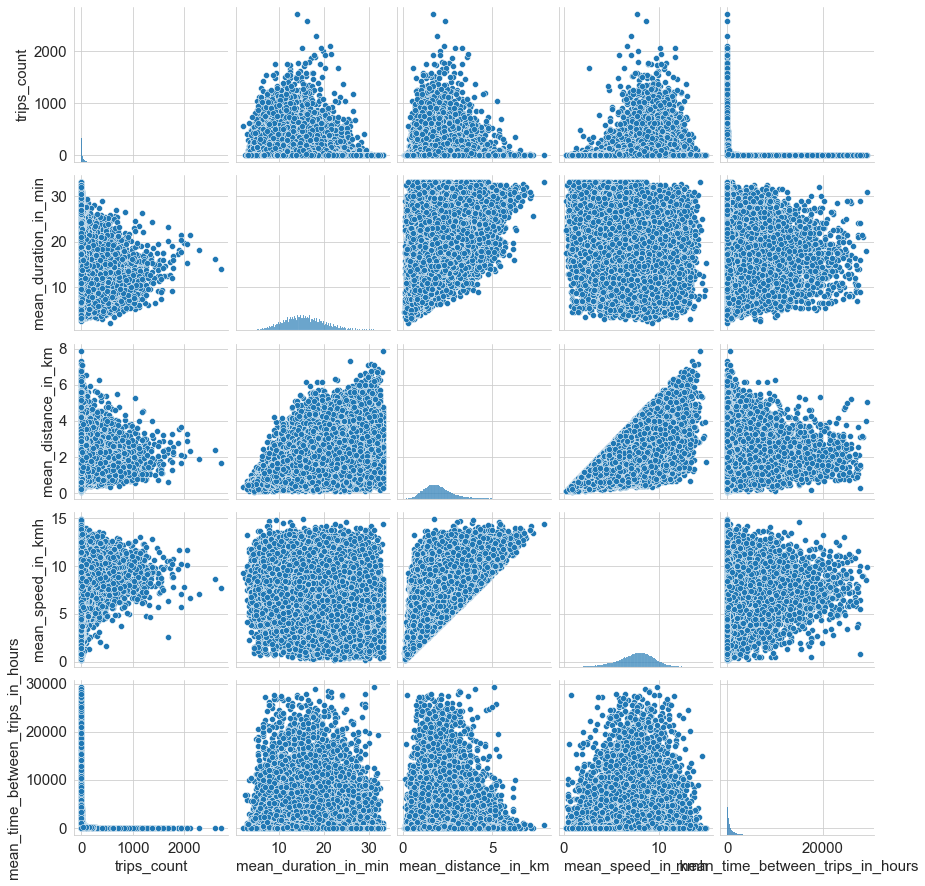

In [38]:
sns.pairplot(
    users[[
        "trips_count",
        "mean_duration_in_min",
        "mean_distance_in_km",
        "mean_speed_in_kmh",
        "mean_time_between_trips_in_hours",
    ]]
)